# RAG VIsual Grounded Stroy Generation

## VPN Setting

In [1]:

import os, requests

# os.environ["https_proxy"]="https://127.0.0.1:7890"
# os.environ["http_proxy"]="http://127.0.0.1:7890"
# os.environ["HTTPS_proxy"]="https://127.0.0.1:7890"
# os.environ["HTTP_proxy"]="http://127.0.0.1:7890"

os.environ["https_proxy"]="http://192.168.0.107:7890"
os.environ["http_proxy"]="http://192.168.0.107:7890"
os.environ["HTTPS_proxy"]="http://192.168.0.107:7890"
os.environ["HTTP_proxy"]="http://192.168.0.107:7890"

print(requests.get("https://google.com"))

<Response [200]>


## Environment

In [2]:
!pip install tqdm numpy pandas matplotlib openai datasets


[notice] A new release of pip is available: 24.0 -> 24.1.2
[notice] To update, run: python3 -m pip install --upgrade pip


In [3]:

import os
import math
from collections import defaultdict
import requests
from PIL import Image
from io import BytesIO
import base64

from tqdm import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import openai
from datasets import load_dataset


/root/miniconda3/envs/vgsg/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [204]:

# OpenAI API Key
# api_key = "YOUR_OPENAI_API_KEY" # Replace this with your real API key
openai.api_key = api_key

## Data Loading

In [12]:
dataset=load_dataset("tonyhong/vwp")
val_data=pd.DataFrame(dataset['val'])
test_data=pd.DataFrame(dataset['test'])
train_data=pd.DataFrame(dataset['train'])

In [13]:
val_data.shape, test_data.shape, train_data.shape

((849, 38), (586, 38), (11778, 38))

In [25]:
val_data[:7]

,scene_full_id,link0,link1,link2,link3,link4,link5,link6,link7,link8,link9,char0,char1,char2,char3,char4,char0_url,char1_url,char2_url,char3_url,char4_url,text0,text1,text2,text3,text4,text5,text6,text7,text8,text9,img_id_list,story,sep_story,anonymised_story,split,imdb_id,story_id
0,tt0047396_0010_0,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0667_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0668_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0671_img_1.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0672_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0693_img_0.jpg,None,None,None,None,None,Grace,James,Thelma,Raymond,{},https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/char_0000.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/char_0001.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/char_0002.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/char_0003.jpg,{},James and Thelma were spying on their neighbor Raymond's apartment.,James noticed an underage girl in the apartment with Raymond. He was worried so he called the police.,James saw Raymond take a knife out of his drawer.,James couldn't believe what he was seeing.,The cops finally got to Raymond's apartment. He was stunned.,None,None,None,None,None,"['tt0047396_0667_0', 'tt0047396_0668_0', 'tt0047396_0671_1', 'tt0047396_0672_0', 'tt0047396_0693_0']",James and Thelma were spying on their neighbor Raymond's apartment. James noticed an underage girl in the apartment with Raymond. He was worried so he called the police. James saw Raymond take a knife out of his drawer. James couldn't believe what he was seeing. The cops finally got to Raymond's apartment. He was stunned.,James and Thelma were spying on their neighbor Raymond's apartment. [SENT] James noticed an underage girl in the apartment with Raymond. He was worried so he called the police. [SENT] James saw Raymond take a knife out of his drawer. [SENT] James couldn't believe what he was seeing. [SENT] The cops finally got to Raymond's apartment. He was stunned. [SENT],[male0] and [female0] were spying on their neighbor [male1] 's apartment . [male0] noticed an underage girl in the apartment with [male1] . he was worried so he called the police . [male0] saw [male1] take a knife out of his drawer . [male0] could n't believe what he was seeing . the cops finally got to [male1] 's apartment . he was stunned .,val,tt0047396,0
1,tt0047396_0010_0,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0667_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0668_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0669_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0670_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0684_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0687_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0688_img_0.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/shot_0693_img_0.jpg,None,None,Grace,James,Thelma,Raymond,{},https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/char_0000.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/char_0001.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/char_0002.jpg,https://datasets.d2.mpi-inf.mpg.de/xhong/VST/alpha4a/tt0047396_0010_0/char_0003.jpg,{},Graces runs from a door as Raymond approaches.,Thelma and James watch worriedly as James talks on the phone.,Raymond walks toward the back of an apartment toward Grace.,Thelma and James continue to watch in silence.,The stress is unbearable

In [21]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)
val_data[:7]['img_id_list']

0                                                                ['tt0047396_0667_0', 'tt0047396_0668_0', 'tt0047396_0671_1', 'tt0047396_0672_0', 'tt0047396_0693_0']
1    ['tt0047396_0667_0', 'tt0047396_0668_0', 'tt0047396_0669_0', 'tt0047396_0670_0', 'tt0047396_0684_0', 'tt0047396_0687_0', 'tt0047396_0688_0', 'tt0047396_0693_0']
2                                                                ['tt0047396_0668_0', 'tt0047396_0669_0', 'tt0047396_0670_0', 'tt0047396_0671_1', 'tt0047396_0672_0']
3                                                                ['tt0047396_0667_0', 'tt0047396_0668_0', 'tt0047396_0671_1', 'tt0047396_0672_0', 'tt0047396_0693_0']
4                                                                ['tt0047396_0667_0', 'tt0047396_0669_0', 'tt0047396_0671_1', 'tt0047396_0687_0', 'tt0047396_0693_0']
5                                                                ['tt0119822_1277_0', 'tt0119822_1278_1', 'tt0119822_1282_2', 'tt0119822_1283_1', 'tt0119822_1284_2']
6   

In [23]:
val_data[:7]['scene_full_id']

0    tt0047396_0010_0
1    tt0047396_0010_0
2    tt0047396_0010_0
3    tt0047396_0010_0
4    tt0047396_0010_0
5    tt0119822_0024_0
6    tt0119822_0024_0
Name: scene_full_id, dtype: object

In [15]:
val_data.keys()

Index(['scene_full_id', 'link0', 'link1', 'link2', 'link3', 'link4', 'link5',
       'link6', 'link7', 'link8', 'link9', 'char0', 'char1', 'char2', 'char3',
       'char4', 'char0_url', 'char1_url', 'char2_url', 'char3_url',
       'char4_url', 'text0', 'text1', 'text2', 'text3', 'text4', 'text5',
       'text6', 'text7', 'text8', 'text9', 'img_id_list', 'story', 'sep_story',
       'anonymised_story', 'split', 'imdb_id', 'story_id'],
      dtype='object')

## Similarity Retriever

In [84]:

import glob
import os
import sys
from functools import reduce

from PIL import Image


def get_image(image_path):
    if image_path[:5]!="https":
        img=Image.open(image_path)

    else:
        response=requests.get(image_path)
        img=Image.open(BytesIO(response.content))

    return img


def image_hash(image1, image2):
    h=avhash(image1)
    f=avhash(image2)

    return hamming(f, h)


def avhash(im):
    if not isinstance(im, Image.Image):
        im = Image.open(im)

    im = im.resize((8, 8), Image.ANTIALIAS).convert('L')
    avg = reduce(lambda x, y: x + y, im.getdata()) / 64.

    tmp=enumerate(map(lambda i: 0 if i < avg else 1, im.getdata()))
    return reduce(lambda x, tuple_arg: x | (tuple_arg[1] << tuple_arg[0]), tmp, 0)

    # return reduce(lambda x, (y, z): x | (z << y),
    #               enumerate(map(lambda i: 0 if i < avg else 1, im.getdata())),
    #               0)


def hamming(h1, h2):
    h, d = 0, h1 ^ h2
    while d:
        h += 1
        d &= d - 1

    return h


In [24]:
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.7/43.7 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.5/40.5 kB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.5/9.5 MB 61.4 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 786.6/786.6 kB 109.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 435.4/435.4 kB 109.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 68.4 MB/s eta 0:00:00a 0:00:01


In [34]:
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM
import torch

tokenizer = AutoTokenizer.from_pretrained("google/flan-t5-base")
embed=tokenizer.encode("hello")
print(embed)
embed_tensor=torch.Tensor(embed)
embed_tensor_padded=torch.nn.functional.pad(embed_tensor, (0, 510))
print(embed_tensor.shape)
print(embed_tensor_padded.shape)

[21820, 1]
torch.Size([2])
torch.Size([512])


In [69]:
# Load model directly
import torch
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM

tokenizer = AutoTokenizer.from_pretrained("google/flan-t5-base")
MAX_LENGTH=768

def preprocess_labelled_data(data):
    
    img_li=[]
    story_li=[]; ano_story_li=[]; ano_embed_story_li=[]

    img_id_dic={}; img_sent_dic={}
    
    index_img_dic={}
    index_sent_dic={}
    index_story_dic={}
    index_ano_story_dic={}
    index_ano_embed_dic={}
    
    # IMG_PRE_PATH='INLG/vgsg/images'

    for story_id in data.index:
        scene_full_id = data.loc[story_id, 'scene_full_id']
        img_id_li = eval(data.loc[story_id, 'img_id_list'])

        # image_paths = [os.path.join(IMG_PRE_PATH, img_id+'.jpg') for img_id in img_id_li]
        human_story = data.loc[story_id, 'story']
        ano_story = data.loc[story_id, 'anonymised_story']
        ano_embed_story=tokenizer.encode(ano_story)
        len_ano_embed=len(ano_embed_story)
        ano_embed_padded=torch.nn.functional.pad(torch.Tensor(ano_embed_story), \
                                                       (0, MAX_LENGTH-len_ano_embed))
        
        story_li.append(human_story)
        ano_story_li.append(ano_story)
        ano_embed_story_li.append(ano_embed_padded)
        
        sep_human_story = data.loc[story_id, 'sep_story']
        sep_human_story=sep_human_story.split('[SENT]')

        img_li.extend(img_id_li)
        img_li=list(set(img_li))

        index_img_dic.setdefault(story_id, []).extend(img_id_li)
        index_sent_dic.setdefault(story_id, []).extend(sep_human_story)
        index_story_dic[story_id]=human_story
        index_ano_story_dic[story_id]=ano_story
        index_ano_embed_dic[story_id]=ano_embed_padded

        for i, img_id in enumerate(img_id_li):
            img_sent_dic.setdefault(img_id, []).append(sep_human_story[i])

    img_id_dic={img:i for i, img in enumerate(img_li)}

    return img_li, story_li, ano_story_li, ano_embed_story_li, img_id_dic, img_sent_dic, index_img_dic
    # index_sent_dic, index_story_dic, index_ano_story_dic, index_ano_embed_dic, \
    

def preprocess_test_data(data):

    img_li=[]
    img_id_dic={}   
    index_img_dic={}

    # IMG_PRE_PATH='INLG/vgsg/images'
    for story_id in data.index:
        scene_full_id = data.loc[story_id, 'scene_full_id']
        img_id_li = eval(data.loc[story_id, 'img_id_list'])

        # image_paths = [os.path.join(IMG_PRE_PATH, img_id+'.jpg') for img_id in img_id_li]
        img_li.extend(img_id_li)
        img_li=list(set(img_li))

        index_img_dic.setdefault(story_id, []).extend(img_id_li)

    img_id_dic={img:i for i, img in enumerate(img_li)}

    return img_li, img_id_dic, index_img_dic


In [70]:
def get_hashes(img_list1, img_list2):
    num_img_1=len(img_list1)
    num_img_2=len(img_list2)

    image_hashes=[[0]*num_img_2 for _ in range(num_img_1)]
    print("image_hashes", image_hashes)

    for idx in range(num_img_1):
        for i in range(num_img_2):
            img_1=get_image(img_list1[idx])
            img_2=get_image(img_list2[i])

            hash=image_hash(img_1, img_2)
            image_hashes[idx][i]=hash

    return image_hashes

In [71]:
import torch

def similarity_matrix(vec_li_1, vec_li_2):
    len_vec_1=len(vec_li_1)
    len_vec_2=len(vec_li_2)

    sim_matrix=[[0]*len_vec_2 for _ in range(len_vec_1)]
    cos = torch.nn.CosineSimilarity(dim=1)

    for idx, vec_1 in enumerate(vec_li_1):
        for i, vec_2 in enumerate(vec_li_2):
            sim=cos(torch.Tensor(vec_1), torch.Tensor(vec_2)).item()
            sim_matrix[idx][i]=sim
            
    return sim_matrix

In [72]:
train_img_li, train_story_li, train_ano_story_li, train_ano_embed_story_li, train_img_id_dic, train_img_sent_dic, train_index_img_dic=preprocess_labelled_data(train_data)
val_img_li, val_story_li, val_ano_story_li, val_ano_embed_story_li, val_img_id_dic, val_img_sent_dic, val_index_img_dic=preprocess_labelled_data(val_data)
test_img_li, test_img_id_dic, test_index_img_dic=preprocess_test_data(test_data)

In [54]:
print(len(trian_img_li), len(train_story_li), len(train_ano_embed_story_li))

16494 11778 11778


In [18]:
test_val_hash=get_hashes(test_img_list, val_img_list)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



# Save&Load

## Save

In [74]:
import pickle

with open('outputs/train_data.json', 'wb') as fd:
    pickle.dump([train_img_li, train_story_li, train_ano_story_li, \
                 train_ano_embed_story_li, train_img_id_dic, train_img_sent_dic, \
                train_index_img_dic],\
               fd, protocol=pickle.HIGHEST_PROTOCOL)

with open('outputs/val_data.json', 'wb') as fd:
    pickle.dump([val_img_li, val_story_li, val_ano_story_li, \
                 val_ano_embed_story_li, val_img_id_dic, val_img_sent_dic, \
                val_index_img_dic],\
               fd, protocol=pickle.HIGHEST_PROTOCOL)
    
with open('outputs/test_data.json', 'wb') as fd:
    pickle.dump([test_img_li, test_img_id_dic, test_index_img_dic],\
               fd, protocol=pickle.HIGHEST_PROTOCOL)


## Load

In [63]:

import pickle

with open('outputs/train_features.json', 'rb') as fd:
    [train_f_img_li, train_f_sce_li, train_f_swin_base_li, \
                         train_f_img_id_dic, train_f_sce_id_dic, train_f_img_swin_base_dic, \
                         train_f_img_target_dic, train_f_img_origin_dic, \
                         train_f_sce_img_target_dic, train_f_sce_img_origin_dic]=\
    pickle.load(fd)
    
with open('outputs/test_features.json', 'rb') as fd:
    [test_f_img_li, test_f_sce_li, test_f_swin_base_li, \
                         test_f_img_id_dic, test_f_sce_id_dic, test_f_img_swin_base_dic, \
                         test_f_img_target_dic, test_f_img_origin_dic, \
                         test_f_sce_img_target_dic, test_f_sce_img_origin_dic]=\
    pickle.load(fd)

with open('outputs/val_features.json', 'rb') as fd:
    [val_f_img_li, val_f_sce_li, val_f_swin_base_li, \
                         val_f_img_id_dic, val_f_sce_id_dic, val_f_img_swin_base_dic, \
                         val_f_img_target_dic, val_f_img_origin_dic, \
                         val_f_sce_img_target_dic, val_f_sce_img_origin_dic]=\
    pickle.load(fd)




In [75]:
import json

with open('outputs/val_train_sim.json', 'r') as fd:
    val_train_sim = json.load(fd)

with open('outputs/test_train_sim.json', 'r') as fd:
    test_train_sim = json.load(fd)

# Generation Functions

In [177]:
import base64
import requests
from PIL import Image
from io import BytesIO
from openai import OpenAI


# Function to encode the image
def encode_image(image_path):
    img = Image.open(image_path)
    
    if img.size[0]*img.size[1]>106320:
        res_img=img.resize((img.size[0]//2, img.size[0]//2))
        buffered = BytesIO()
        res_img.save(buffered, format="JPEG")
        return base64.b64encode(buffered.getvalue()).decode('utf-8')
        
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')


def generate_img_desc_rag(client, model, img_base64, img_exp_base64, desc_exp):

    response = client.chat.completions.create(
        model=model,
        messages=[
            {
                "role": "system",
                "content": """You are a helpful writer. Write a short description
                of this image using around 20 words, based on the given example
                (an image with several descriptions). ###Return just the description and nothing else.""",
            },
            {
                "role": "user",
                "content": [
                    {
                        "type": "text",
                        "text": "Describe the following image.",
                    },
                    {
                        "type": "image_url",
                        "image_url": {
                            "url": f"data:image/jpeg;base64,{img_exp_base64}",
                        },
                    },
                ],
            },
            {"role": "assistant", "content": f"{desc_exp}"},
            {
                "role": "user",
                "content": [
                    {
                        "type": "text",
                        "text": "Describe the following image.",
                    },
                    {
                        "type": "image_url",
                        "image_url": {
                            "url": f"data:image/jpeg;base64,{img_base64}",
                        },
                    },
                ],
            },
        ],
        max_tokens=300,
    )

    # print(response.choices[0].message.content)
    return response.choices[0].message.content


def generate_story(client, model, descriptions, story_example):
    response = client.chat.completions.create(
        model=model,
        messages=[
          {
            "role": "user",
            "content": "Combine the descriptions of images"+ \
              descriptions+ "to write a coherent story using around 100 words, based on\
              a given similar story example"+ story_example+ ". ###Return just the story and nothing else.",
          }
        ],
        temperature=0,
        max_tokens=300,
        top_p=1,
        frequency_penalty=0,
        presence_penalty=0
    )
    story = response.choices[0].message.content
    return story


# Pass all the frames together
def visual_storytelling(client, model, imgs_base64):
    url_list = []
    for image_idx, image_path in tqdm(enumerate(image_paths)):
        # Getting the base64 string
        if image_path[:5] != 'https':
            base64_image = encode_image(image_path)
            url = f"data:image/jpeg;base64,{base64_image}"
        else:
            url = image_path
        url_list.append(url)

    headers = {
    "Content-Type": "application/json",
    "Authorization": f"Bearer {api_key}"
    }
    content = [
              {
                "type": "text",
                "text": "These are frames from a video. Write a coherent short story using no more than 100 words based on these frames. Return just the story and nothing else. "
              }
            ]
    for url in url_list:
        content.append({
                "type": "image_url",
                "image_url": {
                  "url": url,
                }
              })
    payload = {
        "model": "gpt-4-vision-preview",
        "max_tokens": 300,
        "messages" : [
          {
            "role": "user",
            "content": content,
          }
        ]
    }
    response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    return response.json()['choices'][0]['message']['content']





# Generation

In [178]:
!pwd

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


/root/fruitao/vgsg


In [103]:
print(train_ano_embed_story_li[0].shape)
cos = torch.nn.CosineSimilarity(dim=0)
print(cos(train_ano_embed_story_li[0], train_ano_embed_story_li[0]))
print(cos(train_ano_embed_story_li[0], train_ano_embed_story_li[1]))
print(cos(train_ano_embed_story_li[0], train_ano_embed_story_li[2]))

torch.Size([768])
tensor(1.0000)
tensor(0.1043)
tensor(0.0505)


In [207]:
import torch
import matplotlib.pyplot as plt
import random

from PIL import Image
from openai import OpenAI
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM

IMG_PRE_PATH='images'
client = OpenAI(api_key=api_key, base_url='https://api.openai.com/v1')
model="gpt-4o-mini"

def vgsg_rag(tokenizer, tgt_data, tgt_index_img_dic, tgt_src_sim, tgt_f_img_id_dic, \
             src_f_img_li, src_img_sent_dic, src_ano_embed_story_li, src_ano_story_li, \
             output_file, max_length=768):
    gen_story_li=[]
    cos = torch.nn.CosineSimilarity(dim=0)
    # fd=open(output_file, 'w')
    
    for story_id in tgt_data.index[:]:
        tgt_img_id_li=tgt_index_img_dic[story_id]

        tgt_img_path_li=[]
        sim_src_img_path_li=[]; sim_src_img_desc_li=[]
        gen_img_desc_li=[]
        for tgt_img_id in tgt_img_id_li:
            tgt_img_idx=tgt_f_img_id_dic[tgt_img_id]
            _src_sim=tgt_src_sim[tgt_img_idx]
            
            sim_src_img_idx=_src_sim.index(max(_src_sim))
            sim_src_img_id=src_f_img_li[sim_src_img_idx]

            tgt_img_path=os.path.join(IMG_PRE_PATH, tgt_img_id+'.jpg')
            sim_src_img_path=os.path.join(IMG_PRE_PATH, sim_src_img_id+'.jpg')

            tgt_img_base64=encode_image(tgt_img_path)
            sim_src_img_base64=encode_image(sim_src_img_path)
            sim_src_img_desc=src_img_sent_dic[sim_src_img_id]
            # sim_src_img_desc=random.sample(src_img_sent_dic[sim_src_img_id], 1)[0]

            tgt_img_path_li.append(tgt_img_path)
            sim_src_img_path_li.append(sim_src_img_path)
            sim_src_img_desc_li.append(sim_src_img_desc)

            gen_img_desc=generate_img_desc_rag(client, model, tgt_img_base64, \
                                           sim_src_img_base64, sim_src_img_desc)
            gen_img_desc_li.append(gen_img_desc)

        gen_img_desc_str=" ".join(gen_img_desc_li)
        gen_img_desc_embed=tokenizer.encode(gen_img_desc_str)
        gen_img_desc_embed_padded=torch.nn.functional.pad(torch.Tensor(gen_img_desc_embed), \
                                                       (0, max_length-len(gen_img_desc_embed)))

        # Search for the most similar story
        max_sim_score=0; max_sim_idx=0;
        for src_story_id, src_ano_embed_story in enumerate(src_ano_embed_story_li):
            sim_score=cos(src_ano_embed_story, gen_img_desc_embed_padded)
            if sim_score>max_sim_score:
                max_sim_score=sim_score
                max_sim_idx=src_story_id

        print("max_sim_score, max_sim_idx", max_sim_score, max_sim_idx)
        sim_ano_story=src_ano_story_li[max_sim_idx]
        gen_story=generate_story(client, model, gen_img_desc_str, sim_ano_story)
        gen_story_li.append(gen_story)

        # Logs
        fig = plt.figure(figsize=(8, 8))
        columns = len(tgt_img_id_li)
        rows = 2
        for i in range(columns):
            img = Image.open(tgt_img_path_li[i])
            fig.add_subplot(rows, columns, i+1)
            plt.imshow(img)

        for i in range(columns):
            img = Image.open(sim_src_img_path_li[i])
            fig.add_subplot(rows, columns, i+columns+1)
            plt.imshow(img)
        plt.show()

        for i in range(columns):
            print("###description examples:", i, sim_src_img_desc_li[i])
            print("###generated description:", i, gen_img_desc_li[i])

        print("######story_id:{} closest example is:".format(story_id), max_sim_idx, sim_ano_story)
        print("######story_id:{} generated story is:".format(story_id), gen_story)

        # with open('val_gen_story_li.json', 'w') as fd:
        # fd.write(gen_story+'\n') 

    # fd.close()
    return gen_story_li


# Run

## Validation Set

In [179]:
%%time
%%capture cap
del cap 

tokenizer = AutoTokenizer.from_pretrained("google/flan-t5-base")
MAX_LENGTH=768

# The function often interrupts due to openai request error

tgt_data=val_data
tgt_index_img_dic=val_index_img_dic
tgt_src_sim=val_train_sim
tgt_f_img_id_dic=val_f_img_id_dic
src_f_img_li=train_f_img_li
src_img_sent_dic=train_img_sent_dic
src_ano_embed_story_li=train_ano_embed_story_li
src_ano_story_li=train_ano_story_li
output_file="val_gen_stories.txt"
max_length=MAX_LENGTH

gen_story_li=[]
cos = torch.nn.CosineSimilarity(dim=0)
# fd=open(output_file, 'w')

for story_id in tgt_data.index[495:]:
    tgt_img_id_li=tgt_index_img_dic[story_id]

    tgt_img_path_li=[]
    sim_src_img_path_li=[]; sim_src_img_desc_li=[]
    gen_img_desc_li=[]
    for tgt_img_id in tgt_img_id_li:
        tgt_img_idx=tgt_f_img_id_dic[tgt_img_id]
        _src_sim=tgt_src_sim[tgt_img_idx]
        
        sim_src_img_idx=_src_sim.index(max(_src_sim))
        sim_src_img_id=src_f_img_li[sim_src_img_idx]

        tgt_img_path=os.path.join(IMG_PRE_PATH, tgt_img_id+'.jpg')
        sim_src_img_path=os.path.join(IMG_PRE_PATH, sim_src_img_id+'.jpg')

        tgt_img_base64=encode_image(tgt_img_path)
        sim_src_img_base64=encode_image(sim_src_img_path)
        sim_src_img_desc=src_img_sent_dic[sim_src_img_id]
        # sim_src_img_desc=random.sample(src_img_sent_dic[sim_src_img_id], 1)[0]

        tgt_img_path_li.append(tgt_img_path)
        sim_src_img_path_li.append(sim_src_img_path)
        sim_src_img_desc_li.append(sim_src_img_desc)

        gen_img_desc=generate_img_desc_rag(client, model, tgt_img_base64, \
                                       sim_src_img_base64, sim_src_img_desc)
        gen_img_desc_li.append(gen_img_desc)

    gen_img_desc_str=" ".join(gen_img_desc_li)
    gen_img_desc_embed=tokenizer.encode(gen_img_desc_str)
    gen_img_desc_embed_padded=torch.nn.functional.pad(torch.Tensor(gen_img_desc_embed), \
                                                   (0, max_length-len(gen_img_desc_embed)))

    # Search for the most similar story
    max_sim_score=0; max_sim_idx=0;
    for src_story_id, src_ano_embed_story in enumerate(src_ano_embed_story_li):
        sim_score=cos(src_ano_embed_story, gen_img_desc_embed_padded)
        if sim_score>max_sim_score:
            max_sim_score=sim_score
            max_sim_idx=src_story_id

    print("max_sim_score, max_sim_idx", max_sim_score, max_sim_idx)
    sim_ano_story=src_ano_story_li[max_sim_idx]
    gen_story=generate_story(client, model, gen_img_desc_str, sim_ano_story)
    gen_story_li.append(gen_story)

    # Logs
    fig = plt.figure(figsize=(8, 8))
    columns = len(tgt_img_id_li)
    rows = 2
    for i in range(columns):
        img = Image.open(tgt_img_path_li[i])
        fig.add_subplot(rows, columns, i+1)
        plt.imshow(img)

    for i in range(columns):
        img = Image.open(sim_src_img_path_li[i])
        fig.add_subplot(rows, columns, i+columns+1)
        plt.imshow(img)
    plt.show()

    for i in range(columns):
        print("###description examples:", i, sim_src_img_desc_li[i])
        print("###generated description:", i, gen_img_desc_li[i])

    print("######story_id:{} closest example is:".format(story_id), max_sim_idx, sim_ano_story)
    print("######story_id:{} generated story is:".format(story_id), gen_story)

    # with open('val_gen_story_li.json', 'w') as fd:
    # fd.write(gen_story+'\n') 

# fd.close()

# End of the function
val_gen_story_li=gen_story_li

with open('val_gen_story_li.json', 'w') as fd:
    fd.write(json.dumps(val_gen_story_li)) 

CPU times: user 5min 26s, sys: 10.7 s, total: 5min 36s
Wall time: 1h 42min 27s


max_sim_score, max_sim_idx tensor(0.4516) 10367
###description examples: 0 [' One after another patient passes away under his care. ', " Elliot stiches up the patient's face very carefully. His face is still bloody. ", ' Upon checking for a pulse, it was discovered by Donald that the patient was fading fast. ', ' He grabbed the patients neck to stop the bleading. ']
###generated description: 0 The image depicts hands stained with blood, performing a medical procedure on an injured individual in a chaotic scene.
###description examples: 1 [' The platoon has taken over an abandoned German sandsack-fortified machine gun position. ', ' The platoon has taken over an abandoned German sandsack-fortified machine gun position. ']
###generated description: 1 A soldier is pointing a gun at a captured enemy, illustrating a tense standoff amid a war-like setting.
###description examples: 2 [' Barry and Adam stopped picking up rocks. ', ' A lot of the other soldiers agreed but all wished they were b

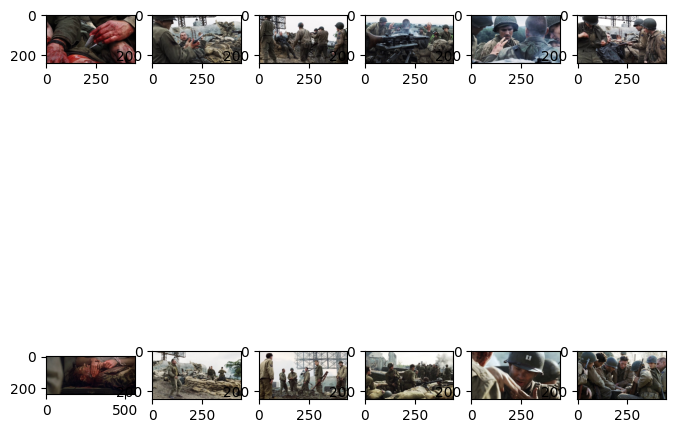

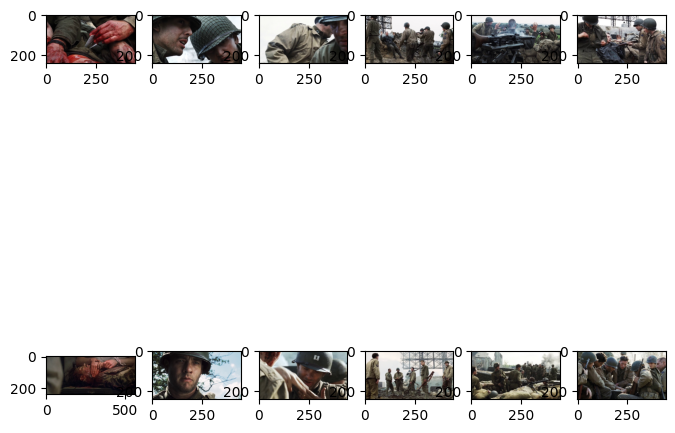

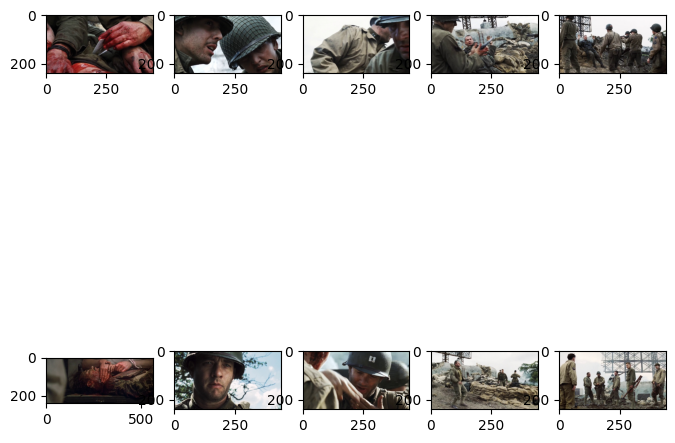

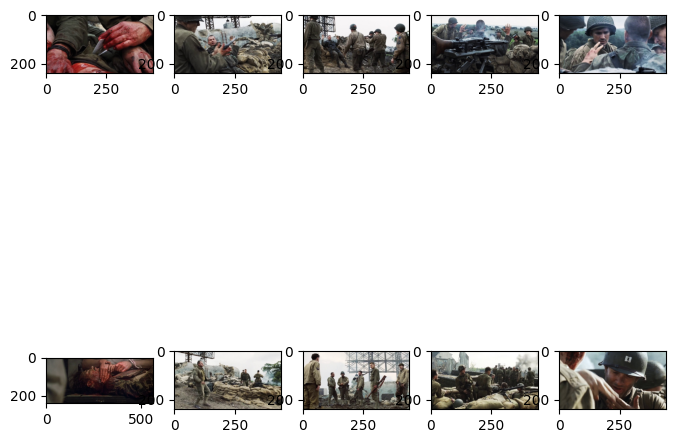

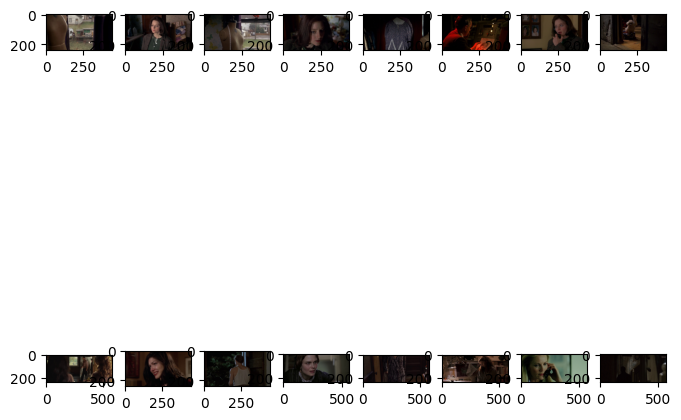

...

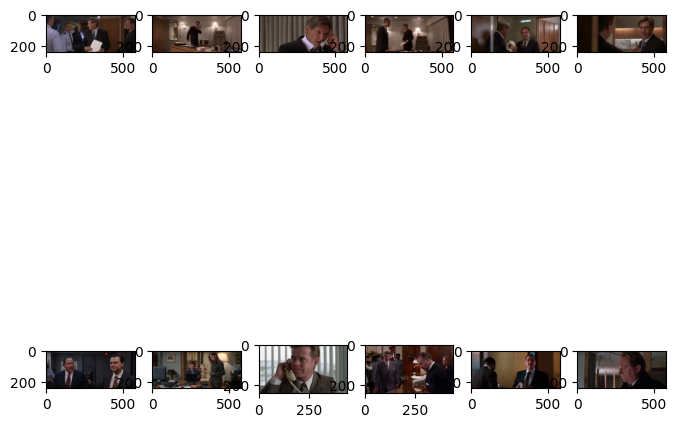

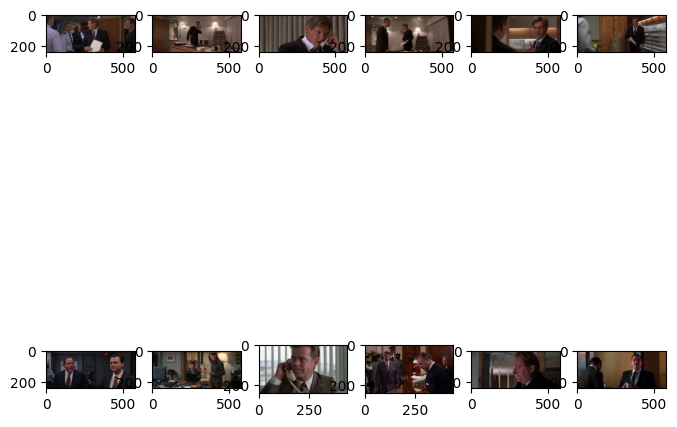

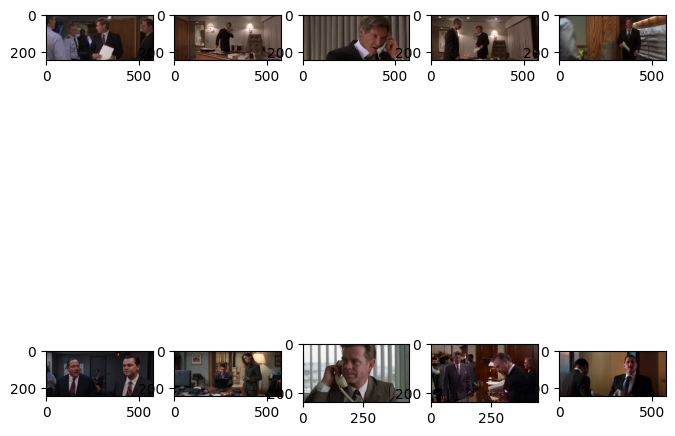

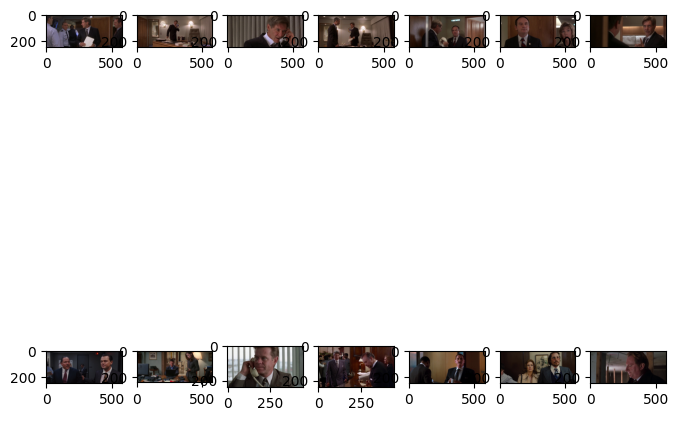

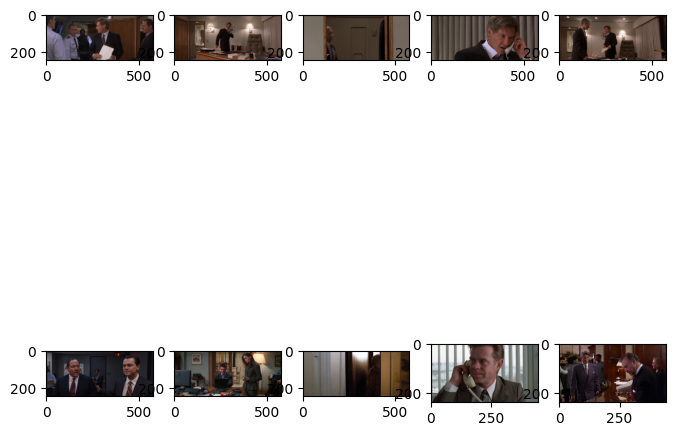

In [180]:
with open('val_gen_story.log', 'w') as f:
    f.write(cap.stdout)
cap()

In [181]:
val_gen_story_li=gen_story_li
print(len(val_gen_story_li))
with open('val_gen_story_li_495_.json', 'w') as fd:
    fd.write(json.dumps(val_gen_story_li)) 

In [156]:
%%time
%%capture cap
del cap 

tokenizer = AutoTokenizer.from_pretrained("google/flan-t5-base")
MAX_LENGTH=768

val_gen_story_li=vgsg_rag(tokenizer, val_data, val_index_img_dic, val_train_sim, \
                          val_f_img_id_dic, train_f_img_li, train_img_sent_dic, \
                          train_ano_embed_story_li, train_ano_story_li, output_file="val_gen_stories.txt")

import json

with open('val_gen_story_li.json', 'w') as fd:
    fd.write(json.dumps(val_gen_story_li)) 

KeyboardInterrupt: 

CPU times: user 39.1 s, sys: 419 ms, total: 39.5 s
Wall time: 15min 56s


## Test Set

In [ ]:
%%time
%%capture cap
del cap 

tokenizer = AutoTokenizer.from_pretrained("google/flan-t5-base")
MAX_LENGTH=768

# The function often interrupts due to openai request error

tgt_data=val_data
tgt_index_img_dic=test_index_img_dic
tgt_src_sim=test_train_sim
tgt_f_img_id_dic=test_f_img_id_dic
src_f_img_li=train_f_img_li
src_img_sent_dic=train_img_sent_dic
src_ano_embed_story_li=train_ano_embed_story_li
src_ano_story_li=train_ano_story_li
output_file="test_gen_stories.txt"
max_length=MAX_LENGTH

gen_story_li=[]
cos = torch.nn.CosineSimilarity(dim=0)
# fd=open(output_file, 'w')

for story_id in tgt_data.index[123:]:
    tgt_img_id_li=tgt_index_img_dic[story_id]

    tgt_img_path_li=[]
    sim_src_img_path_li=[]; sim_src_img_desc_li=[]
    gen_img_desc_li=[]
    for tgt_img_id in tgt_img_id_li:
        tgt_img_idx=tgt_f_img_id_dic[tgt_img_id]
        _src_sim=tgt_src_sim[tgt_img_idx]
        
        sim_src_img_idx=_src_sim.index(max(_src_sim))
        sim_src_img_id=src_f_img_li[sim_src_img_idx]

        tgt_img_path=os.path.join(IMG_PRE_PATH, tgt_img_id+'.jpg')
        sim_src_img_path=os.path.join(IMG_PRE_PATH, sim_src_img_id+'.jpg')

        tgt_img_base64=encode_image(tgt_img_path)
        sim_src_img_base64=encode_image(sim_src_img_path)
        sim_src_img_desc=src_img_sent_dic[sim_src_img_id]
        # sim_src_img_desc=random.sample(src_img_sent_dic[sim_src_img_id], 1)[0]

        tgt_img_path_li.append(tgt_img_path)
        sim_src_img_path_li.append(sim_src_img_path)
        sim_src_img_desc_li.append(sim_src_img_desc)

        gen_img_desc=generate_img_desc_rag(client, model, tgt_img_base64, \
                                       sim_src_img_base64, sim_src_img_desc)
        gen_img_desc_li.append(gen_img_desc)

    gen_img_desc_str=" ".join(gen_img_desc_li)
    gen_img_desc_embed=tokenizer.encode(gen_img_desc_str)
    gen_img_desc_embed_padded=torch.nn.functional.pad(torch.Tensor(gen_img_desc_embed), \
                                                   (0, max_length-len(gen_img_desc_embed)))

    # Search for the most similar story
    max_sim_score=0; max_sim_idx=0;
    for src_story_id, src_ano_embed_story in enumerate(src_ano_embed_story_li):
        sim_score=cos(src_ano_embed_story, gen_img_desc_embed_padded)
        if sim_score>max_sim_score:
            max_sim_score=sim_score
            max_sim_idx=src_story_id

    print("max_sim_score, max_sim_idx", max_sim_score, max_sim_idx)
    sim_ano_story=src_ano_story_li[max_sim_idx]
    gen_story=generate_story(client, model, gen_img_desc_str, sim_ano_story)
    gen_story_li.append(gen_story)

    # Logs
    fig = plt.figure(figsize=(8, 8))
    columns = len(tgt_img_id_li)
    rows = 2
    for i in range(columns):
        img = Image.open(tgt_img_path_li[i])
        fig.add_subplot(rows, columns, i+1)
        plt.imshow(img)

    for i in range(columns):
        img = Image.open(sim_src_img_path_li[i])
        fig.add_subplot(rows, columns, i+columns+1)
        plt.imshow(img)
    plt.show()

    for i in range(columns):
        print("###description examples:", i, sim_src_img_desc_li[i])
        print("###generated description:", i, gen_img_desc_li[i])

    print("######story_id:{} closest example is:".format(story_id), max_sim_idx, sim_ano_story)
    print("######story_id:{} generated story is:".format(story_id), gen_story)

    # with open('val_gen_story_li.json', 'w') as fd:
    # fd.write(gen_story+'\n') 

# fd.close()

# End of the function
test_gen_story_li=gen_story_li

with open('test_gen_story_li.json', 'w') as fd:
    fd.write(json.dumps(test_gen_story_li)) 

In [ ]:
with open('test_gen_story.log', 'w') as f:
    f.write(cap.stdout)
cap()

In [ ]:
test_gen_story_li=gen_story_li
print(len(test_gen_story_li))
with open('test_gen_story_li_123_.json', 'w') as fd:
    fd.write(json.dumps(test_gen_story_li)) 

In [211]:
print(len(test_gen_story_li))

463


In [ ]:
%%time
%%capture cap
del cap 

tokenizer = AutoTokenizer.from_pretrained("google/flan-t5-base")
MAX_LENGTH=768
    
test_gen_story_li=vgsg_rag(tokenizer, test_data, test_index_img_dic, test_train_sim, test_f_img_id_dic, \
         train_f_img_li, train_img_sent_dic, train_ano_embed_story_li, train_ano_story_li, , output_file="test_gen_stories.json")

import json

with open('test_gen_story_li.json', 'w') as fd:
    fd.write(json.dumps(test_gen_story_li)) 

# Evaluation

In [144]:
print(len(val_data), len(val_gen_story_li))
print(len(test_data), len(test_gen_story_li))

849 2


NameError: name 'test_gen_story_li' is not defined

In [146]:
val_gen_story_li

['Late at night, a woman and a man stood by the windows of a brick apartment building, both looking anxious. The man, speaking on the phone, seemed deeply concerned, while the woman beside him appeared worried. In the adjacent window, a man held a drink, and an unused desk and lamp were visible. Downstairs, a man with grey hair and a serious expression stood with someone in a patterned shirt. Inside, an older man with gray hair and glasses, dressed in a blue suit and tie, looked on thoughtfully. The tension in the air was palpable as they awaited crucial news.',
 'In a dimly lit brick apartment, tension filled the air. A man in a suit stood by the window, talking on the phone, while a woman looked worriedly at him. On the balcony, plants swayed gently. In the neighboring apartment, a desk lamp illuminated a man and woman, both appearing serious. The man held an object, their focus intense. An older woman in a brown dress and a man in a pink shirt exchanged worried glances. Meanwhile, a

# Test Generation

In [51]:

img_base64=encode_image(image_path=image_list[0])
img_exp_base64=encode_image(image_path=image_list[1])
dsc_exp=image_sent_dict[image_list[1]]

print("img_base64", img_base64)
print("img_exp_base64", img_exp_base64)
print("dsc_exp", dsc_exp)

client = OpenAI(api_key=api_key, base_url='https://api.openai.com/v1')
model="gpt-4o"

desc=generate_img_desc_rag(client, model, img_base64=img_base64, img_exp_base64=img_exp_base64, desc_exp=dsc_exp)
print("desc", desc)

img_base64 /9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQECAgICAgQDAgICAgUEBAMEBgUGBgYFBgYGBwkIBgcJBwYGCAsICQoKCgoKBggLDAsKDAkKCgr/2wBDAQICAgICAgUDAwUKBwYHCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgr/wAARCADwAY0DASIAAhEBAxEB/8QAHwAAAQUBAQEBAQEAAAAAAAAAAAECAwQFBgcICQoL/8QAtRAAAgEDAwIEAwUFBAQAAAF9AQIDAAQRBRIhMUEGE1FhByJxFDKBkaEII0KxwRVS0fAkM2JyggkKFhcYGRolJicoKSo0NTY3ODk6Q0RFRkdISUpTVFVWV1hZWmNkZWZnaGlqc3R1dnd4eXqDhIWGh4iJipKTlJWWl5iZmqKjpKWmp6ipqrKztLW2t7i5usLDxMXGx8jJytLT1NXW19jZ2uHi4+Tl5ufo6erx8vP09fb3+Pn6/8QAHwEAAwEBAQEBAQEBAQAAAAAAAAECAwQFBgcICQoL/8QAtREAAgECBAQDBAcFBAQAAQJ3AAECAxEEBSExBhJBUQdhcRMiMoEIFEKRobHBCSMzUvAVYnLRChYkNOEl8RcYGRomJygpKjU2Nzg5OkNERUZHSElKU1RVVldYWVpjZGVmZ2hpanN0dXZ3eHl6goOEhYaHiImKkpOUlZaXmJmaoqOkpaanqKmqsrO0tba3uLm6wsPExcbHyMnK0tPU1dbX2Nna4uPk5ebn6Onq8vP09fb3+Pn6/9oADAMBAAIRAxEAPwD8DptIu4DiS1cEHGCKqzps6jBr2b4lfDubSrWe6t1wVGfu45/CvGbsyecyydQeeK6qtF0pWZ0T9n7NOPUiooorE5x4IIyKdtIG49KYh5we9Od9q4HP1pq5aasRnqas2ikAVWAycVdiQhACO1EYt6l0VeVyxChkU

# Evaluation

In [197]:
with open('val_gen_story_li_0_494.json', 'r') as fd:
    val_gen_story_li_0_494 = json.load(fd)

with open('val_gen_story_li_495_.json', 'r') as fd:
    val_gen_story_li_495_ = json.load(fd)

val_gen_story_li=val_gen_story_li_0_494.copy()
val_gen_story_li.extend(val_gen_story_li_495_)

In [198]:
print(len(val_gen_story_li_0_494), len(val_gen_story_li_495_), len(val_gen_story_li))

495 354 849


In [203]:
import pandas

story_id_li=[]
val_story_img_id_li=[]

for story_id in val_data.index:
    val_img_id_li=val_index_img_dic[story_id]
    story_id_li.append(story_id)
    val_story_img_id_li.append(val_img_id_li)

result_dict = {'story_id': story_id_li, 'img_id_list': val_story_img_id_li, 'generated_story': val_gen_story_li} 
result_df = pd.DataFrame(result_dict)

result_df.to_csv('val_result.csv', encoding='utf-8', index=False, header=True)

In [217]:
with open('test_gen_story_li_0_122.json', 'r') as fd:
    test_gen_story_li_0_122 = json.load(fd)

with open('test_gen_story_li_123_.json', 'r') as fd:
    test_gen_story_li_123_ = json.load(fd)

test_gen_story_li=test_gen_story_li_0_122.copy()
test_gen_story_li.extend(test_gen_story_li_123_)

In [219]:
print(len(test_gen_story_li_0_122), len(test_gen_story_li_123_), len(test_gen_story_li))
print(len(test_data))

123 463 586
586


In [220]:
import pandas

story_id_li=[]
test_story_img_id_li=[]

for story_id in test_data.index:
    test_img_id_li=test_index_img_dic[story_id]
    story_id_li.append(story_id)
    test_story_img_id_li.append(test_img_id_li)

result_dict = {'story_id': story_id_li, 'img_id_list': test_story_img_id_li, 'generated_story': test_gen_story_li} 
result_df = pd.DataFrame(result_dict)

result_df.to_csv('test_result.csv', encoding='utf-8', index=False, header=True)